# Functions

## Initialisation

In [1]:
import os

path = os.getcwd()
# find the string 'project' in the path, return index
index_project = path.find('project')
# slice the path from the index of 'project' to the end
project_path = path[:index_project+7]
# set the working directory
os.chdir(project_path)
print(f'Project path set to: {os.getcwd()}')


Project path set to: c:\Github\ode-biomarker-project


In [2]:
from PathLoader import PathLoader
path_loader = PathLoader('data_config.env', 'current_user.env')

In [3]:
from DataLink import DataLink
data_link = DataLink(path_loader, 'data_codes.csv')

# CCLE mRNA expression dataset

In [28]:
# load in data

import pandas as pd
import pickle

# import GDSC2 drug response data using pickle

with open('data/drug-response/GDSC2/cache_gdsc2.pkl', 'rb') as f:
    gdsc2 = pickle.load(f)
    gdsc2_info = pickle.load(f)

# import CCLE gene expression data using pickle

with open('data/gene-expression/CCLE_Public_22Q2/ccle_expression.pkl', 'rb') as f:
    gene_entrez = pickle.load(f)
    ccle = pickle.load(f)

# import CCLE sample info data using pickle

with open('data/gene-expression/CCLE_Public_22Q2/ccle_sample_info.pkl', 'rb') as f:
    ccle_sample_info = pickle.load(f)


In [29]:
ccle.head()

,CELLLINE,TSPAN6,TNMD,DPM1,SCYL3,C1orf112,FGR,CFH,FUCA2,GCLC,...,H3C2,H3C3,AC098582.1,DUS4L-BCAP29,C8orf44-SGK3,ELOA3B,NPBWR1,ELOA3D,ELOA3,CDR1
0,ACH-001113,4.331992,0.000000,7.364397,2.792855,4.470537,0.028569,1.226509,3.042644,6.499686,...,2.689299,0.189034,0.201634,2.130931,0.555816,0.0,0.275007,0.0,0.0,0.000000
1,ACH-001289,4.566815,0.584963,7.106537,2.543496,3.504620,0.000000,0.189034,3.813525,4.221104,...,1.286881,1.049631,0.321928,1.464668,0.632268,0.0,0.014355,0.0,0.0,0.000000
2,ACH-001339,3.150560,0.000000,7.379032,2.333424,4.227279,0.056584,1.310340,6.687061,3.682573,...,0.594549,1.097611,0.831877,2.946731,0.475085,0.0,0.084064,0.0,0.0,0.042644
3,ACH-001538,5.085340,0.000000,7.154109,2.545968,3.084064,0.000000,5.868143,6.165309,4.489928,...,0.214125,0.632268,0.298658,1.641546,0.443607,0.0,0.028569,0.0,0.0,0.000000
4,ACH-000242,6.729145,0.000000,6.537607,2.456806,3.867896,0.799087,7.208381,5.569856,7.127014,...,1.117695,2.358959,0.084064,1.910733,0.000000,0.0,0.464668,0.0,0.0,0.000000


In [30]:
# get the average expression of each gene across all cell lines
gene_means = ccle.select_dtypes(include="number").mean()

In [31]:
mean_df = gene_means.reset_index()
mean_df.columns = ["gene", "mean_expression"]
mean_df.head()

,gene,mean_expression
0,TSPAN6,3.363532
1,TNMD,0.069776
2,DPM1,6.495860
3,SCYL3,2.366410
4,C1orf112,3.674362


In [32]:
# get the mean of the mean expressions
mean_of_means = mean_df['mean_expression'].mean()
print(f'Mean of mean expressions: {mean_of_means}')

# how many genes have mean expression greater than the mean of means
num_genes_above_mean = (mean_df['mean_expression'] > mean_of_means
).sum()
print(f'Number of genes with mean expression above the mean of means: {num_genes_above_mean}')

# below mean of means
num_genes_below_mean = (mean_df['mean_expression'] <= mean_of_means
).sum()
print(f'Number of genes with mean expression below or equal to the mean of means: {num_genes_below_mean}')

# max and min mean expression
max_mean_expression = mean_df['mean_expression'].max()
min_mean_expression = mean_df['mean_expression'].min()

print(f'Max mean expression: {max_mean_expression}')
print(f'Min mean expression: {min_mean_expression}')

# how many zero mean expressions
num_zero_mean_expressions = (mean_df['mean_expression'] == 0).sum()
print(f'Number of genes with zero mean expression: {num_zero_mean_expressions}')

Mean of mean expressions: 2.6217317247252647
Number of genes with mean expression above the mean of means: 9046
Number of genes with mean expression below or equal to the mean of means: 10175
Max mean expression: 15.22380299893061
Min mean expression: 1.0210023454530583e-05
Number of genes with zero mean expression: 0


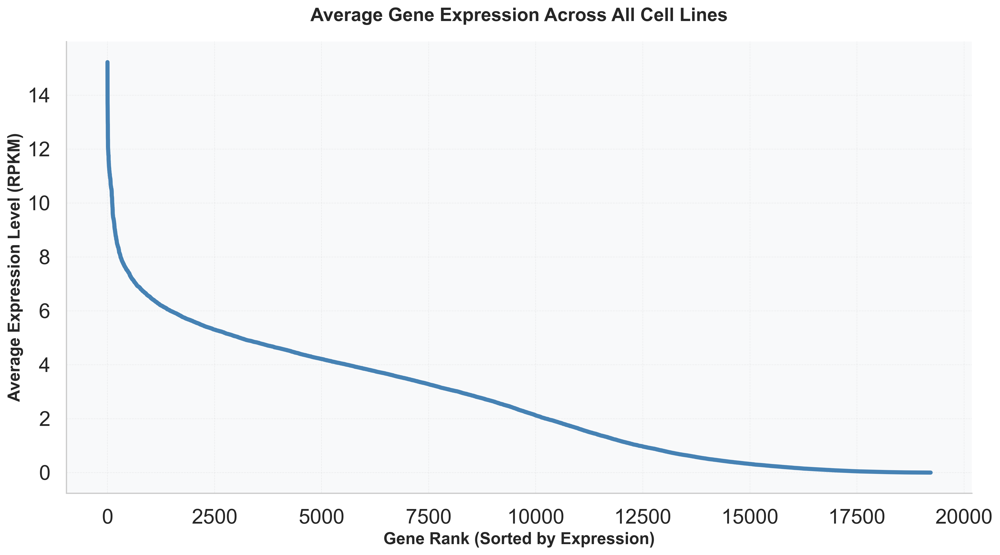

In [33]:

import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib as mpl

sns.set_theme(style="whitegrid")
# # sort by mean descending so the biggest are at top
mean_df_sorted = mean_df.sort_values("mean_expression", ascending=False)

# # use seaborn to plot a horizontal line plot of all the average gene expressions, but do not plot legends or labels for each gene
# plt.figure(figsize=(20, 10))
# sns.lineplot(x="gene", y="mean_expression", data=mean_df_sorted, palette="viridis", hue="mean_expression")
# # remove y axis labels
# plt.yticks([])
# # add labels and title
# plt.xlabel("Average Expression")
# plt.ylabel("Gene")
# plt.title("Average Gene Expression Across All Cell Lines")
# plt.tight_layout()
# plt.show()



# Set journal-quality formatting
plt.rcParams.update(
    {
        "font.size": 24,
        "font.family": "sans",
        "font.serif": ["Arial"],
        "figure.dpi": 300,
        "savefig.dpi": 300,
        "axes.linewidth": 1.2,
        "lines.linewidth": 3,
        "axes.labelsize": 20,
        "axes.titlesize": 24,
        "xtick.labelsize": 18,
        "ytick.labelsize": 18,
        "xtick.major.width": 1.5,
        "ytick.major.width": 1.5,
        "xtick.major.size": 12,
        "ytick.major.size": 12,
    }
)

# Create the figure with journal-quality dimensions
fig, ax = plt.subplots(figsize=(14, 8))

# Plot the data
ax.plot(mean_df_sorted["mean_expression"].values, color="steelblue", linewidth=4)

# Customize the plot
ax.set_xlabel("Gene Rank (Sorted by Expression)", fontsize=16, fontweight="bold")
ax.set_ylabel("Average Expression Level (RPKM)", fontsize=16, fontweight="bold")
ax.set_title(
    "Average Gene Expression Across All Cell Lines",
    fontsize=18,
    fontweight="bold",
    pad=20,
)

# Improve tick labels
ax.tick_params(axis="both", which="major", labelsize=20)
ax.grid(True, alpha=0.3, linestyle="--", linewidth=0.5)

# Remove spines for cleaner look
ax.spines["top"].set_visible(False)
ax.spines["right"].set_visible(False)

# Add a subtle background
ax.set_facecolor("#f8f9fa")

# Adjust layout
plt.tight_layout()
plt.show()

In [34]:
# randomly selected 10 columns from ccle
import numpy as np
# generate 10 random integers between 0 and len(ccle.columns)
random_cols = np.random.randint(0, len(ccle.columns), 10)

In [35]:
CDK4_example = ccle.loc[:, 'CDK4']

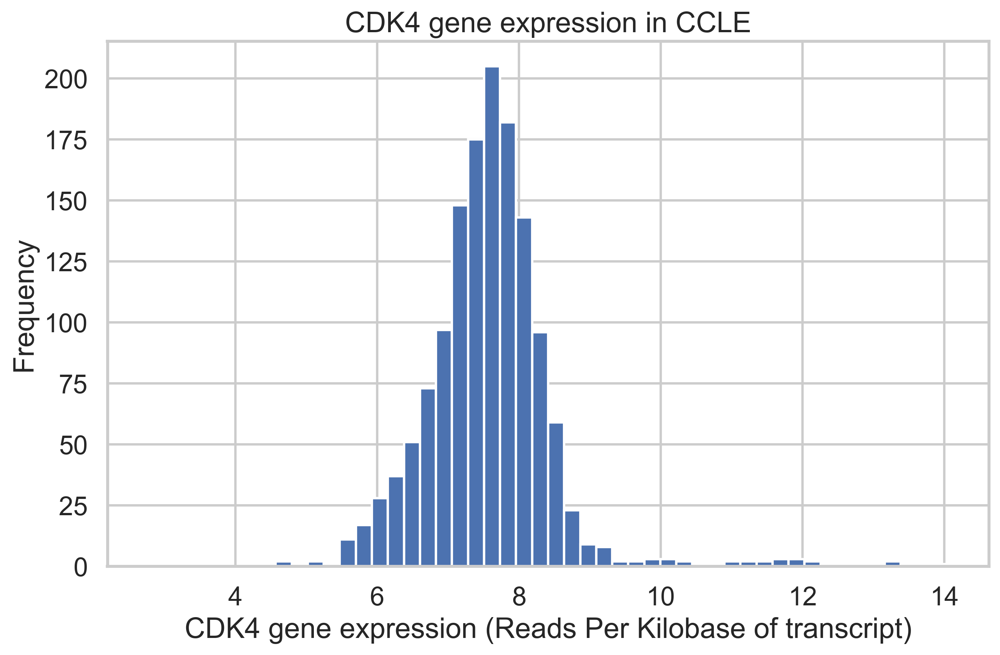

In [36]:
# plot CDK4 gene expression as a histogram

import matplotlib.pyplot as plt
import seaborn as sns

sns.set_style('whitegrid')
sns.set_context('talk')

plt.figure(figsize=(10, 6))
plt.hist(CDK4_example, bins=50)
plt.xlabel('CDK4 gene expression (Reads Per Kilobase of transcript)')
plt.ylabel('Frequency')
plt.title('CDK4 gene expression in CCLE')
plt.show()


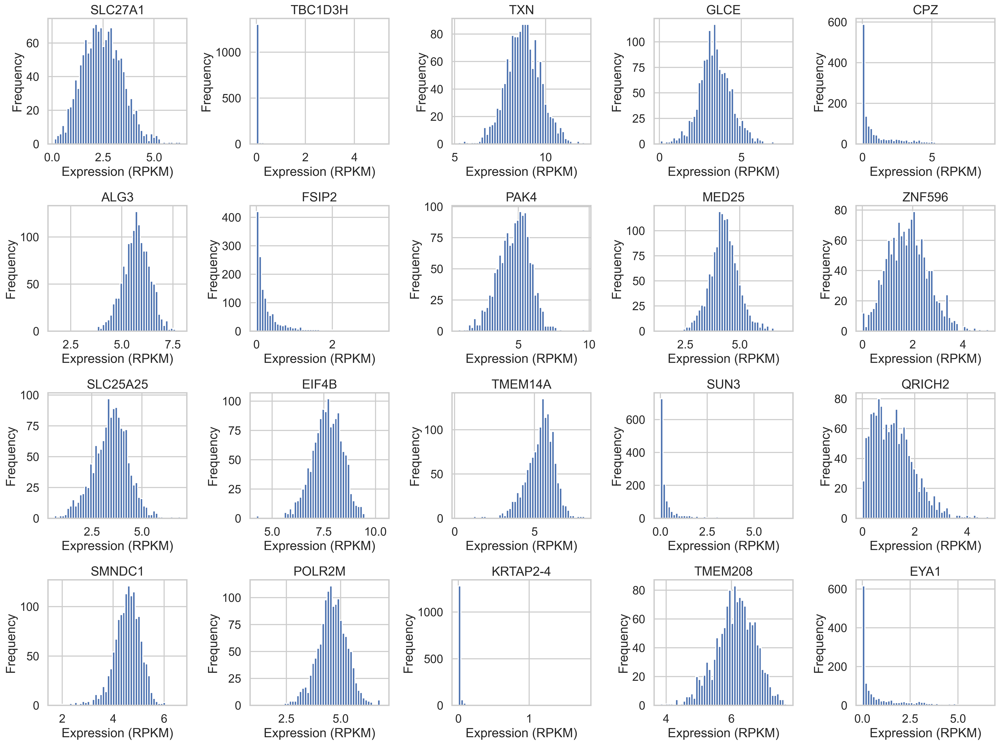

In [37]:
import numpy as np
# generate 10 random integers between 0 and len(ccle.columns)
random_cols = np.random.randint(0, len(ccle.columns), 20)

# plot 20 random genes as histograms, 4 rows, 5 columns

fig, axes = plt.subplots(4, 5, figsize=(20, 15))
for i, ax in enumerate(axes.flatten()):
    ax.hist(ccle.iloc[:, random_cols[i]], bins=50)
    ax.set_title(ccle.columns[random_cols[i]])
    ax.set_xlabel('Expression (RPKM)')
    ax.set_ylabel('Frequency')
plt.tight_layout()
plt.show()



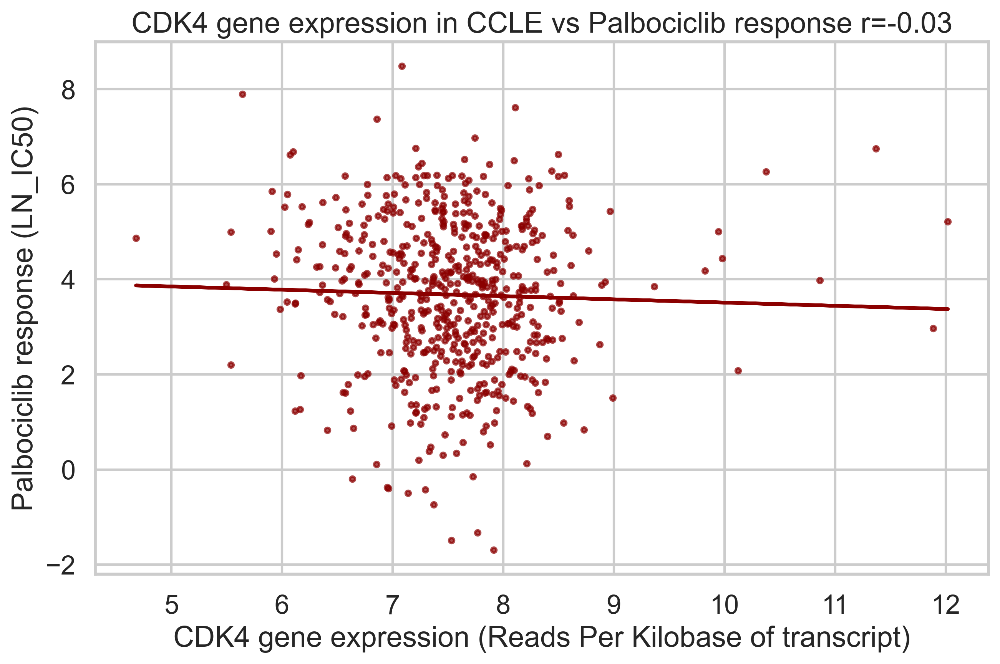

In [38]:
# correlate cdk4 expression with drug response

import DataFunctions as utils 

# import external libraries
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np


# create a joint dataframe of cdk4 expression and drug response for palbociclib
palbociclib_df = utils.create_joint_dataset_from_ccle_gdsc2('Palbociclib', gdsc2, ccle, ccle_sample_info)

# plot correlation between cdk4 expression and palbociclib response

sns.set_style('whitegrid')
sns.set_context('talk')

plt.figure(figsize=(10, 6))
plt.scatter(palbociclib_df['CDK4'], palbociclib_df['LN_IC50'], color='darkred', alpha=0.7, s=10)
# create line of best fit
m, b = np.polyfit(palbociclib_df['CDK4'], palbociclib_df['LN_IC50'], 1)
plt.plot(palbociclib_df['CDK4'], m*palbociclib_df['CDK4'] + b, color='darkred')
# show correlation coefficient in the title
corr = str(round(np.corrcoef(palbociclib_df['CDK4'], palbociclib_df['LN_IC50'])[0, 1], 2))
plt.xlabel('CDK4 gene expression (Reads Per Kilobase of transcript)')
plt.ylabel('Palbociclib response (LN_IC50)')
plt.title(f'CDK4 gene expression in CCLE vs Palbociclib response r={corr}')
plt.show()

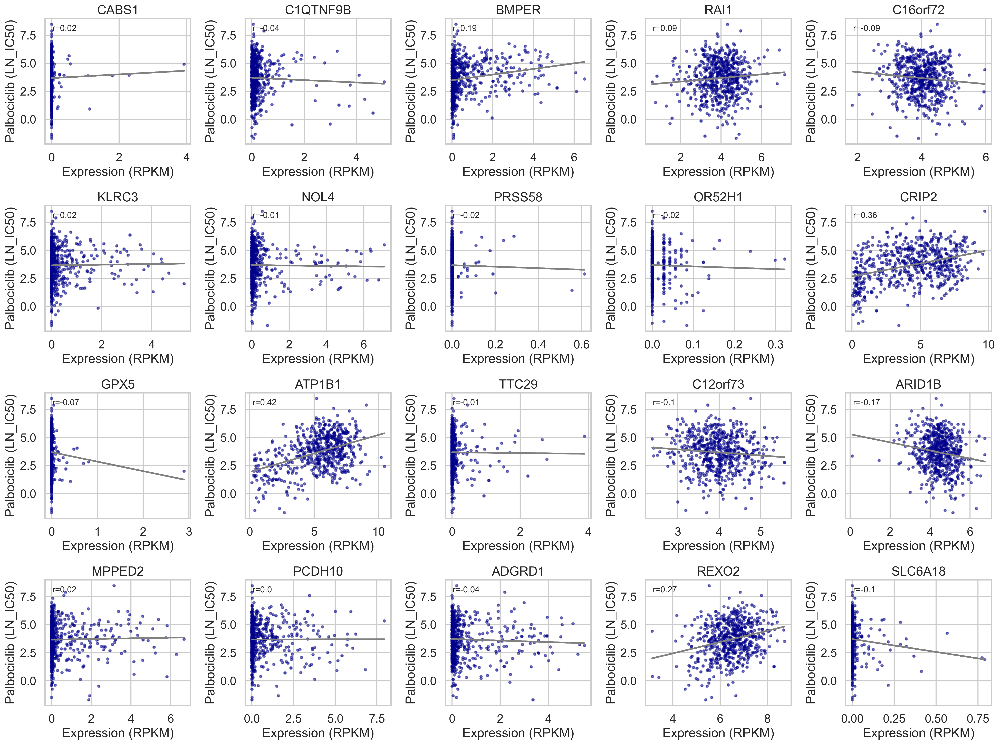

In [39]:
# for 20 random genes, plot correlation between gene expression and drug response

# generate 20 random integers between 0 and len(ccle.columns)
random_cols = np.random.randint(0, len(ccle.columns), 20)

# plot 20 random genes as histograms, 4 rows, 5 columns

fig, axes = plt.subplots(4, 5, figsize=(20, 15))
for i, ax in enumerate(axes.flatten()):
    # create a joint dataframe of gene expression and drug response for palbociclib
    gene = ccle.columns[random_cols[i]]
    # plot correlation between gene expression and palbociclib response
    ax.scatter(palbociclib_df[gene], palbociclib_df['LN_IC50'], color='darkblue', alpha=0.5, s=10)
    # create line of best fit
    m, b = np.polyfit(palbociclib_df[gene], palbociclib_df['LN_IC50'], 1)
    ax.plot(palbociclib_df[gene], m*palbociclib_df[gene] + b, color='grey')
    # get correlation coefficient 
    corr = str(round(np.corrcoef(palbociclib_df[gene], palbociclib_df['LN_IC50'])[0, 1], 2))
    # insert correlation coefficient into text
    ax.text(0.05, 0.95, f'r={corr}', transform=ax.transAxes, fontsize=12, verticalalignment='top')
    ax.set_title(f'{gene}')
    ax.set_xlabel('Expression (RPKM)')
    ax.set_ylabel('Palbociclib (LN_IC50)')
plt.tight_layout()
plt.show()

In [40]:
feature_data, label_data = utils.create_feature_and_label(palbociclib_df)

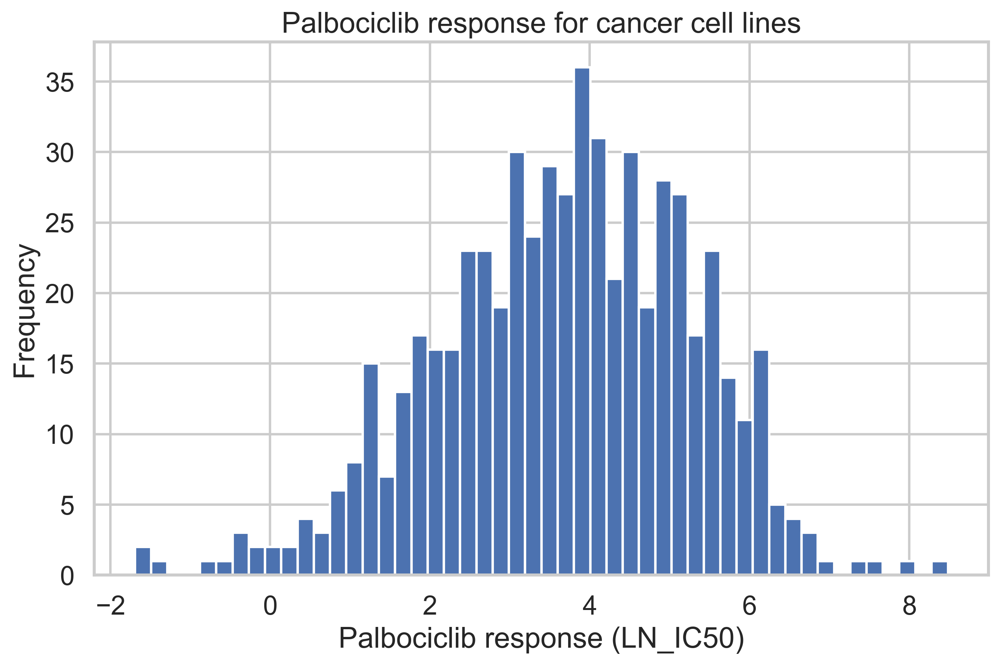

In [41]:
# histogram of label data

sns.set_style('whitegrid')
sns.set_context('talk')

plt.figure(figsize=(10, 6))
plt.hist(label_data, bins=50)
plt.xlabel('Palbociclib response (LN_IC50)')
plt.ylabel('Frequency')
plt.title('Palbociclib response for cancer cell lines')
plt.show()

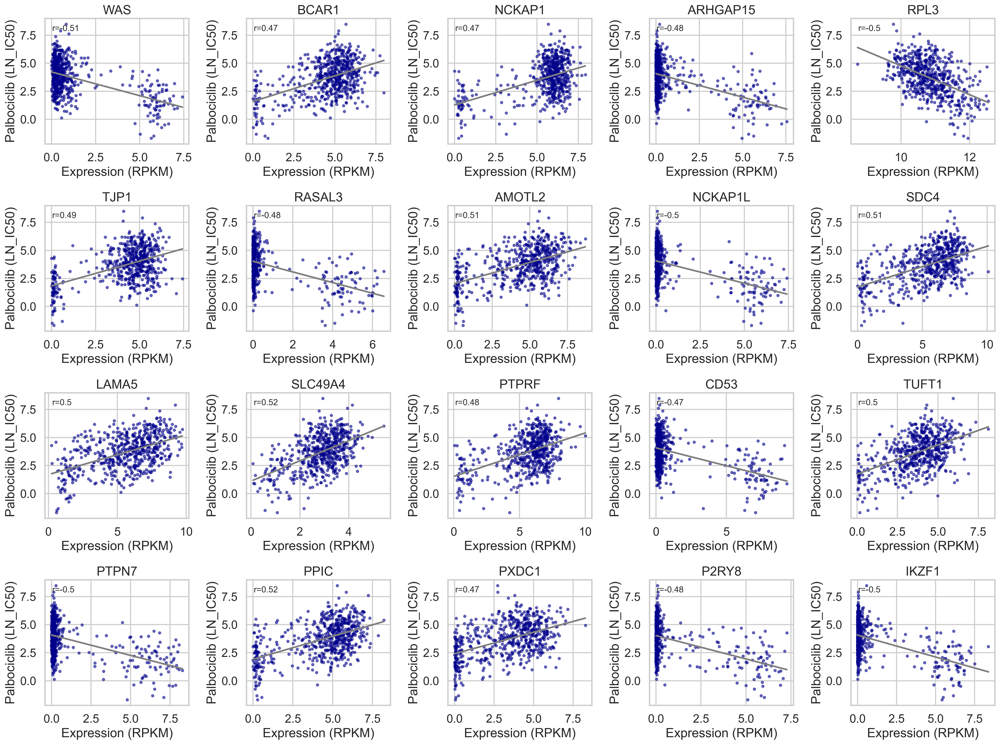

In [42]:
# using f-regression, select the top 20 features

from sklearn.feature_selection import SelectKBest, f_regression

# select the top 20 features
selector = SelectKBest(f_regression, k=20)
selector.fit(feature_data, label_data)

# get the names of the top 20 features return index = true
top_20_features_original = feature_data.columns[selector.get_support(indices=True)]

fig, axes = plt.subplots(4, 5, figsize=(20, 15))
for i, ax in enumerate(axes.flatten()):
    # create a joint dataframe of gene expression and drug response for palbociclib
    # print(top_20_features[i])
    gene = top_20_features_original[i]
    # plot correlation between gene expression and palbociclib response
    ax.scatter(palbociclib_df[gene], palbociclib_df['LN_IC50'], color='darkblue', alpha=0.5, s=10)
    # create line of best fit
    m, b = np.polyfit(palbociclib_df[gene], palbociclib_df['LN_IC50'], 1)
    ax.plot(palbociclib_df[gene], m*palbociclib_df[gene] + b, color='grey')
    # get correlation coefficient 
    corr = str(round(np.corrcoef(palbociclib_df[gene], palbociclib_df['LN_IC50'])[0, 1], 2))
    # insert correlation coefficient into text
    ax.text(0.05, 0.95, f'r={corr}', transform=ax.transAxes, fontsize=12, verticalalignment='top')
    ax.set_title(f'{gene}')
    ax.set_xlabel('Expression (RPKM)')
    ax.set_ylabel('Palbociclib (LN_IC50)')
plt.tight_layout()
plt.show()


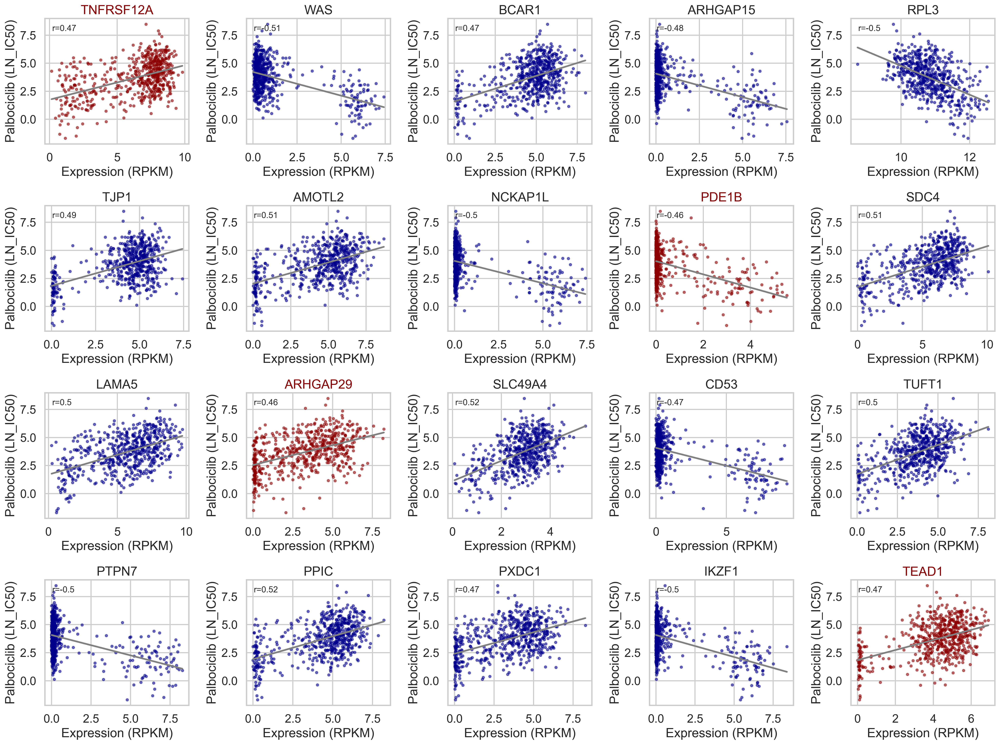

In [43]:
# using train_test_split, split the data into training and testing sets

from sklearn.model_selection import train_test_split

# split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(feature_data, label_data, test_size=0.2, random_state=2)

# select the top 20 features in the training set
selector = SelectKBest(f_regression, k=20)
selector.fit(X_train, y_train)

# get the names of the top 20 features return index = true
top_20_features = feature_data.columns[selector.get_support(indices=True)]

fig, axes = plt.subplots(4, 5, figsize=(20, 15))
for i, ax in enumerate(axes.flatten()):
    # create a joint dataframe of gene expression and drug response for palbociclib
    # print(top_20_features[i])
    gene = top_20_features[i]
    # plot correlation between gene expression and palbociclib response
    # make plot dark red if gene is not in original top 20 features
    if gene not in top_20_features_original:
        ax.scatter(palbociclib_df[gene], palbociclib_df['LN_IC50'], color='darkred', alpha=0.5, s=10)
    else:
        ax.scatter(palbociclib_df[gene], palbociclib_df['LN_IC50'], color='darkblue', alpha=0.5, s=10)
    # create line of best fit
    m, b = np.polyfit(palbociclib_df[gene], palbociclib_df['LN_IC50'], 1)
    ax.plot(palbociclib_df[gene], m*palbociclib_df[gene] + b, color='grey')
    # get correlation coefficient 
    corr = str(round(np.corrcoef(palbociclib_df[gene], palbociclib_df['LN_IC50'])[0, 1], 2))
    # insert correlation coefficient into text
    ax.text(0.05, 0.95, f'r={corr}', transform=ax.transAxes, fontsize=12, verticalalignment='top')
    # make title red if gene is not in original top 20 features
    if gene not in top_20_features_original:
        ax.set_title(f'{gene}', color='darkred')
    else:
        ax.set_title(f'{gene}')
    ax.set_xlabel('Expression (RPKM)')
    ax.set_ylabel('Palbociclib (LN_IC50)')
plt.tight_layout()
plt.show()


# Goncalves Proteomics Dataset

### Basic Visuals

In [44]:
import pandas as pd
import pickle

# import GDSC2 drug response data using pickle

with open('data/drug-response/GDSC2/cache_gdsc2.pkl', 'rb') as f:
    gdsc2 = pickle.load(f)
    gdsc2_info = pickle.load(f)

# import proteomic expression 
with open('data/proteomic-expression/goncalves-2022-cell/goncalve_proteome_processed.pkl', 'rb') as f:
    joined_full_protein_matrix = pickle.load(f)
    joined_sin_peptile_exclusion_matrix = pickle.load(f)

In [45]:
# get mean proteomic expression for each protein
protein_means = joined_sin_peptile_exclusion_matrix.mean()

protein_mean_df = protein_means.reset_index()
protein_mean_df.columns = ["protein", "mean_expression"]
protein_mean_df.head()


,protein,mean_expression
0,P37108;SRP14_HUMAN,6.466039
1,Q96JP5;ZFP91_HUMAN,3.607759
2,Q9Y4H2;IRS2_HUMAN,2.647074
3,P36578;RL4_HUMAN,7.315308
4,Q6SPF0;SAMD1_HUMAN,3.360244


In [27]:
# get the mean of the mean expressions
mean_df = protein_mean_df
mean_of_means = mean_df['mean_expression'].mean()
print(f'Mean of mean expressions: {mean_of_means}')

# how many genes have mean expression greater than the mean of means
num_genes_above_mean = (mean_df['mean_expression'] > mean_of_means
).sum()
print(f'Number of genes with mean expression above the mean of means: {num_genes_above_mean}')

# below mean of means
num_genes_below_mean = (mean_df['mean_expression'] <= mean_of_means
).sum()
print(f'Number of genes with mean expression below or equal to the mean of means: {num_genes_below_mean}')

# max and min mean expression
max_mean_expression = mean_df['mean_expression'].max()
min_mean_expression = mean_df['mean_expression'].min()

print(f'Max mean expression: {max_mean_expression}')
print(f'Min mean expression: {min_mean_expression}')

# how many zero mean expressions
num_zero_mean_expressions = (mean_df['mean_expression'] == 0).sum()
print(f'Number of genes with zero mean expression: {num_zero_mean_expressions}')

Mean of mean expressions: 3.694050812603664
Number of genes with mean expression above the mean of means: 2776
Number of genes with mean expression below or equal to the mean of means: 3916
Max mean expression: 13.45003717597471
Min mean expression: 0.14484136363636366
Number of genes with zero mean expression: 0


In [46]:
mean_df

,gene,mean_expression
0,TSPAN6,3.363532
1,TNMD,0.069776
2,DPM1,6.495860
3,SCYL3,2.366410
4,C1orf112,3.674362
...,...,...
19216,ELOA3B,0.019751
19217,NPBWR1,0.273345
19218,ELOA3D,0.020256
19219,ELOA3,0.027820


In [47]:
protein_mean_df

,protein,mean_expression
0,P37108;SRP14_HUMAN,6.466039
1,Q96JP5;ZFP91_HUMAN,3.607759
2,Q9Y4H2;IRS2_HUMAN,2.647074
3,P36578;RL4_HUMAN,7.315308
4,Q6SPF0;SAMD1_HUMAN,3.360244
...,...,...
6687,Q7Z3B1;NEGR1_HUMAN,3.484849
6688,O60669;MOT2_HUMAN,1.742722
6689,Q13571;LAPM5_HUMAN,3.381009
6690,Q96JM2;ZN462_HUMAN,3.110338


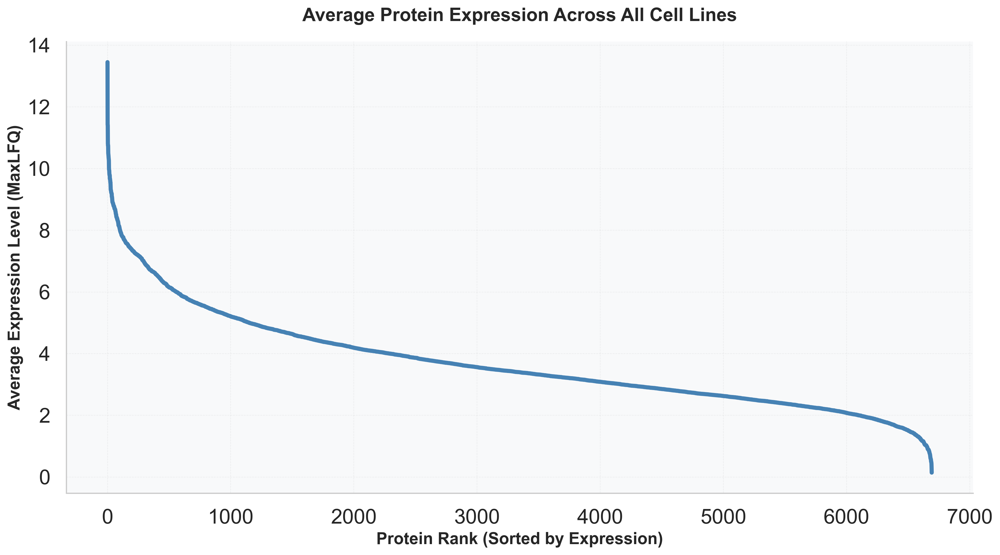

In [49]:

import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib as mpl

sns.set_theme(style="whitegrid")
# # sort by mean descending so the biggest are at top
mean_df_sorted = protein_mean_df.sort_values("mean_expression", ascending=False)

# # use seaborn to plot a horizontal line plot of all the average gene expressions, but do not plot legends or labels for each gene
# plt.figure(figsize=(20, 10))
# sns.lineplot(x="gene", y="mean_expression", data=mean_df_sorted, palette="viridis", hue="mean_expression")
# # remove y axis labels
# plt.yticks([])
# # add labels and title
# plt.xlabel("Average Expression")
# plt.ylabel("Gene")
# plt.title("Average Gene Expression Across All Cell Lines")
# plt.tight_layout()
# plt.show()



# Set journal-quality formatting
plt.rcParams.update(
    {
        "font.size": 24,
        "font.family": "sans",
        "font.serif": ["Arial"],
        "figure.dpi": 300,
        "savefig.dpi": 300,
        "axes.linewidth": 1.2,
        "lines.linewidth": 3,
        "axes.labelsize": 20,
        "axes.titlesize": 24,
        "xtick.labelsize": 18,
        "ytick.labelsize": 18,
        "xtick.major.width": 1.5,
        "ytick.major.width": 1.5,
        "xtick.major.size": 12,
        "ytick.major.size": 12,
    }
)

# Create the figure with journal-quality dimensions
fig, ax = plt.subplots(figsize=(14, 8))

# Plot the data
ax.plot(mean_df_sorted["mean_expression"].values, color="steelblue", linewidth=4)

# Customize the plot
ax.set_xlabel("Protein Rank (Sorted by Expression)", fontsize=16, fontweight="bold")
ax.set_ylabel("Average Expression Level (MaxLFQ)", fontsize=16, fontweight="bold")
ax.set_title(
    "Average Protein Expression Across All Cell Lines",
    fontsize=18,
    fontweight="bold",
    pad=20,
)

# Improve tick labels
ax.tick_params(axis="both", which="major", labelsize=20)
ax.grid(True, alpha=0.3, linestyle="--", linewidth=0.5)

# Remove spines for cleaner look
ax.spines["top"].set_visible(False)
ax.spines["right"].set_visible(False)

# Add a subtle background
ax.set_facecolor("#f8f9fa")

# Adjust layout
plt.tight_layout()
plt.show()

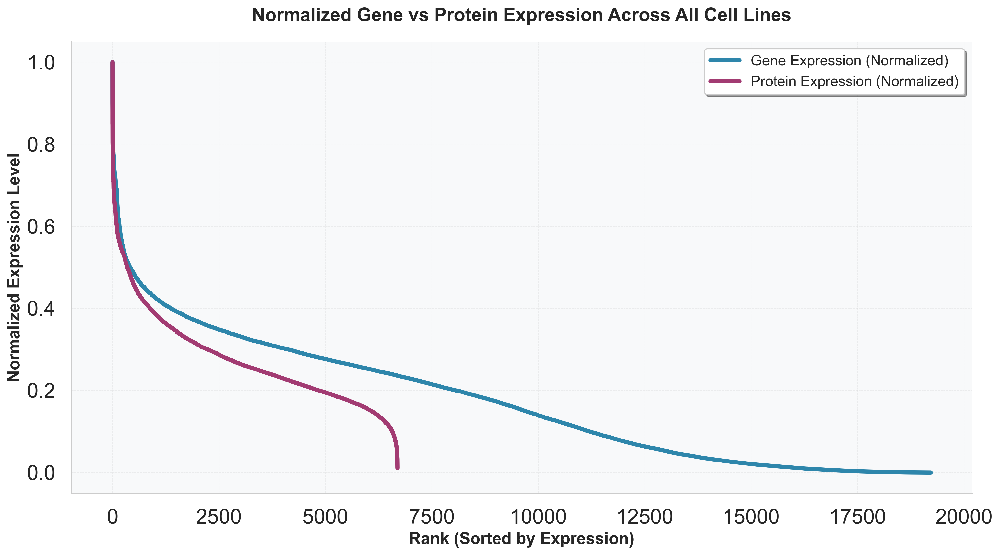

In [50]:
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib as mpl
import numpy as np

sns.set_theme(style="whitegrid")

# Set journal-quality formatting
plt.rcParams.update(
    {
        "font.size": 24,
        "font.family": "sans",
        "font.serif": ["Arial"],
        "figure.dpi": 300,
        "savefig.dpi": 300,
        "axes.linewidth": 1.2,
        "lines.linewidth": 3,
        "axes.labelsize": 20,
        "axes.titlesize": 24,
        "xtick.labelsize": 18,
        "ytick.labelsize": 18,
        "xtick.major.width": 1.5,
        "ytick.major.width": 1.5,
        "xtick.major.size": 12,
        "ytick.major.size": 12,
    }
)

# Sort both dataframes by mean descending
gene_mean_sorted = mean_df.sort_values("mean_expression", ascending=False)
protein_mean_sorted = protein_mean_df.sort_values("mean_expression", ascending=False)

# Normalize to respective max values
gene_normalized = (
    gene_mean_sorted["mean_expression"] / gene_mean_sorted["mean_expression"].max()
)
protein_normalized = (
    protein_mean_sorted["mean_expression"]
    / protein_mean_sorted["mean_expression"].max()
)

# Create the figure with journal-quality dimensions
fig, ax = plt.subplots(figsize=(14, 8))

# Plot both normalized datasets
ax.plot(
    gene_normalized.values,
    color="#2E86AB",
    linewidth=4,
    label="Gene Expression (Normalized)",
)
ax.plot(
    protein_normalized.values,
    color="#A23B72",
    linewidth=4,
    label="Protein Expression (Normalized)",
)

# Customize the plot
ax.set_xlabel("Rank (Sorted by Expression)", fontsize=16, fontweight="bold")
ax.set_ylabel("Normalized Expression Level", fontsize=16, fontweight="bold")
ax.set_title(
    "Normalized Gene vs Protein Expression Across All Cell Lines",
    fontsize=18,
    fontweight="bold",
    pad=20,
)

# Improve tick labels
ax.tick_params(axis="both", which="major", labelsize=20)
ax.grid(True, alpha=0.3, linestyle="--", linewidth=0.5)

# Remove spines for cleaner look
ax.spines["top"].set_visible(False)
ax.spines["right"].set_visible(False)

# Add legend
ax.legend(fontsize=14, frameon=True, fancybox=True, shadow=True)

# Add a subtle background
ax.set_facecolor("#f8f9fa")

# Adjust layout
plt.tight_layout()
plt.show()


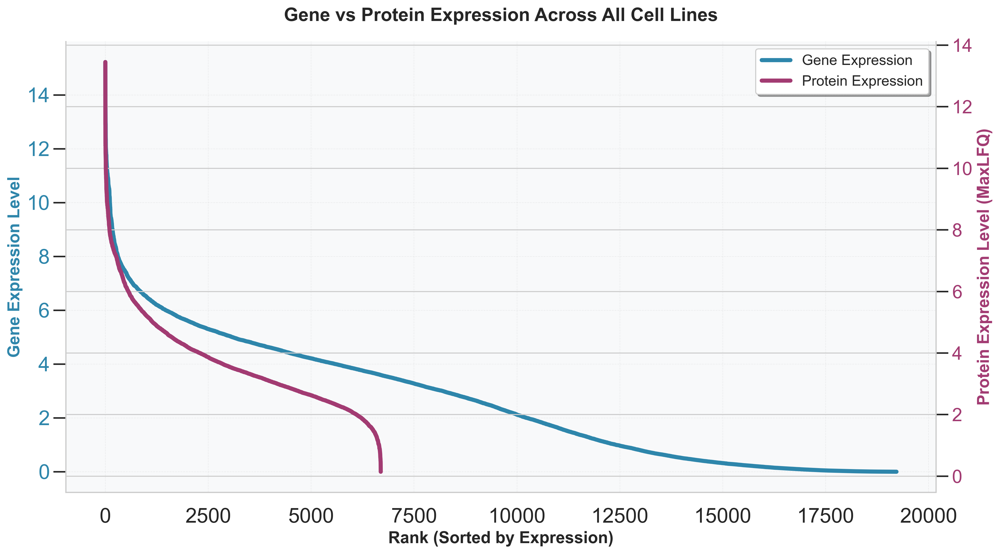

In [51]:
# Create the figure with journal-quality dimensions
fig, ax1 = plt.subplots(figsize=(14, 8))

# Plot gene expression on primary axis
ax1.plot(
    gene_mean_sorted["mean_expression"].values,
    color="#2E86AB",
    linewidth=4,
    label="Gene Expression",
)
ax1.set_xlabel("Rank (Sorted by Expression)", fontsize=16, fontweight="bold")
ax1.set_ylabel("Gene Expression Level", fontsize=16, fontweight="bold", color="#2E86AB")
ax1.tick_params(axis="y", labelcolor="#2E86AB")

# Create secondary axis for protein expression
ax2 = ax1.twinx()
ax2.plot(
    protein_mean_sorted["mean_expression"].values,
    color="#A23B72",
    linewidth=4,
    label="Protein Expression",
)
ax2.set_ylabel(
    "Protein Expression Level (MaxLFQ)", fontsize=16, fontweight="bold", color="#A23B72"
)
ax2.tick_params(axis="y", labelcolor="#A23B72")

# Customize the plot
ax1.set_title(
    "Gene vs Protein Expression Across All Cell Lines",
    fontsize=18,
    fontweight="bold",
    pad=20,
)

# Improve tick labels
ax1.tick_params(axis="both", which="major", labelsize=20)
ax1.grid(True, alpha=0.3, linestyle="--", linewidth=0.5)

# Remove spines for cleaner look
ax1.spines["top"].set_visible(False)
ax2.spines["top"].set_visible(False)

# Combine legends from both axes
lines1, labels1 = ax1.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
ax1.legend(
    lines1 + lines2,
    labels1 + labels2,
    fontsize=14,
    frameon=True,
    fancybox=True,
    shadow=True,
)

# Add a subtle background
ax1.set_facecolor("#f8f9fa")

# Adjust layout
plt.tight_layout()
plt.show()


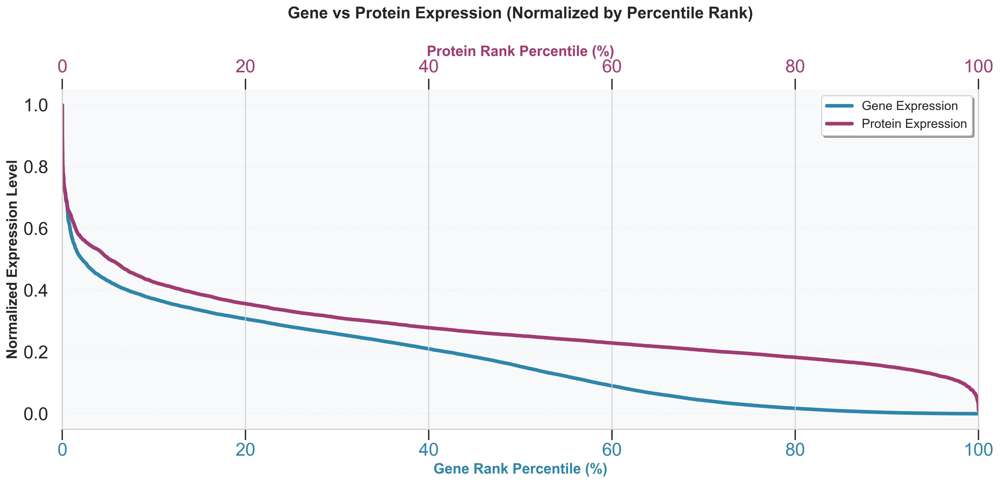

In [53]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

sns.set_theme(style="whitegrid")

# Set journal-quality formatting
plt.rcParams.update(
    {
        "font.size": 24,
        "font.family": "sans",
        "font.serif": ["Arial"],
        "figure.dpi": 300,
        "savefig.dpi": 300,
        "axes.linewidth": 1.2,
        "lines.linewidth": 3,
        "axes.labelsize": 20,
        "axes.titlesize": 24,
        "xtick.labelsize": 18,
        "ytick.labelsize": 18,
        "xtick.major.width": 1.5,
        "ytick.major.width": 1.5,
        "xtick.major.size": 12,
        "ytick.major.size": 12,
    }
)

# Sort both dataframes by mean descending
gene_mean_sorted = mean_df.sort_values("mean_expression", ascending=False)
protein_mean_sorted = protein_mean_df.sort_values("mean_expression", ascending=False)

# Normalize to respective max values
gene_normalized = (
    gene_mean_sorted["mean_expression"] / gene_mean_sorted["mean_expression"].max()
)
protein_normalized = (
    protein_mean_sorted["mean_expression"]
    / protein_mean_sorted["mean_expression"].max()
)

# Create percentage indices for both datasets
gene_percentage = np.linspace(0, 100, len(gene_normalized))
protein_percentage = np.linspace(0, 100, len(protein_normalized))

# Create the figure with dual x-axes
fig, ax1 = plt.subplots(figsize=(16, 8))

# Plot gene expression on primary x-axis
ax1.plot(
    gene_percentage,
    gene_normalized.values,
    color="#2E86AB",
    linewidth=4,
    label="Gene Expression",
)
ax1.set_xlabel(
    "Gene Rank Percentile (%)", fontsize=16, fontweight="bold", color="#2E86AB"
)
ax1.set_ylabel("Normalized Expression Level", fontsize=16, fontweight="bold")
ax1.tick_params(axis="x", labelcolor="#2E86AB")

# Create secondary x-axis for protein expression
ax2 = ax1.twiny()  # Create a second x-axis at the top
ax2.plot(
    protein_percentage,
    protein_normalized.values,
    color="#A23B72",
    linewidth=4,
    label="Protein Expression",
)
ax2.set_xlabel(
    "Protein Rank Percentile (%)", fontsize=16, fontweight="bold", color="#A23B72"
)
ax2.tick_params(axis="x", labelcolor="#A23B72")

# Set the same x-limits for both axes
ax1.set_xlim(0, 100)
ax2.set_xlim(0, 100)

# Customize the plot
ax1.set_title(
    "Gene vs Protein Expression (Normalized by Percentile Rank)",
    fontsize=18,
    fontweight="bold",
    pad=30,
)

# Improve tick labels
ax1.tick_params(axis="both", which="major", labelsize=20)
ax2.tick_params(axis="x", which="major", labelsize=20)
ax1.grid(True, alpha=0.3, linestyle="--", linewidth=0.5)

# Remove spines for cleaner look
ax1.spines["top"].set_visible(False)
ax1.spines["right"].set_visible(False)
ax2.spines["top"].set_visible(False)

# Add legend
lines1, labels1 = ax1.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
ax1.legend(
    lines1 + lines2,
    labels1 + labels2,
    fontsize=14,
    frameon=True,
    fancybox=True,
    shadow=True,
    loc="upper right",
)

# Add a subtle background
ax1.set_facecolor("#f8f9fa")

# Adjust layout
plt.tight_layout()
plt.show()


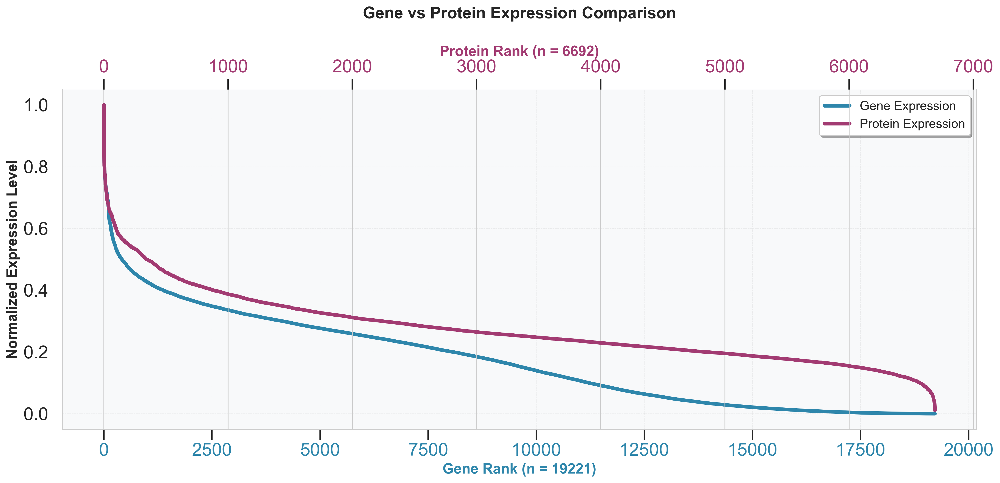

In [54]:
# Create the figure with dual x-axes showing actual counts
fig, ax1 = plt.subplots(figsize=(16, 8))

# Plot gene expression on primary x-axis (actual gene indices)
ax1.plot(
    range(len(gene_normalized)),
    gene_normalized.values,
    color="#2E86AB",
    linewidth=4,
    label="Gene Expression",
)
ax1.set_xlabel(
    "Gene Rank (n = {})".format(len(gene_normalized)),
    fontsize=16,
    fontweight="bold",
    color="#2E86AB",
)
ax1.set_ylabel("Normalized Expression Level", fontsize=16, fontweight="bold")
ax1.tick_params(axis="x", labelcolor="#2E86AB")

# Create secondary x-axis for protein expression (actual protein indices)
ax2 = ax1.twiny()
ax2.plot(
    range(len(protein_normalized)),
    protein_normalized.values,
    color="#A23B72",
    linewidth=4,
    label="Protein Expression",
)
ax2.set_xlabel(
    "Protein Rank (n = {})".format(len(protein_normalized)),
    fontsize=16,
    fontweight="bold",
    color="#A23B72",
)
ax2.tick_params(axis="x", labelcolor="#A23B72")

# Customize the plot
ax1.set_title(
    "Gene vs Protein Expression Comparison",
    fontsize=18,
    fontweight="bold",
    pad=30,
)

# Improve tick labels and grid
ax1.tick_params(axis="both", which="major", labelsize=20)
ax2.tick_params(axis="x", which="major", labelsize=20)
ax1.grid(True, alpha=0.3, linestyle="--", linewidth=0.5)

# Remove spines for cleaner look
ax1.spines["top"].set_visible(False)
ax1.spines["right"].set_visible(False)
ax2.spines["top"].set_visible(False)

# Add legend
lines1, labels1 = ax1.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
ax1.legend(
    lines1 + lines2,
    labels1 + labels2,
    fontsize=14,
    frameon=True,
    fancybox=True,
    shadow=True,
    loc="upper right",
)

# Add a subtle background
ax1.set_facecolor("#f8f9fa")

# Adjust layout
plt.tight_layout()
plt.show()


### Generating Heat Maps


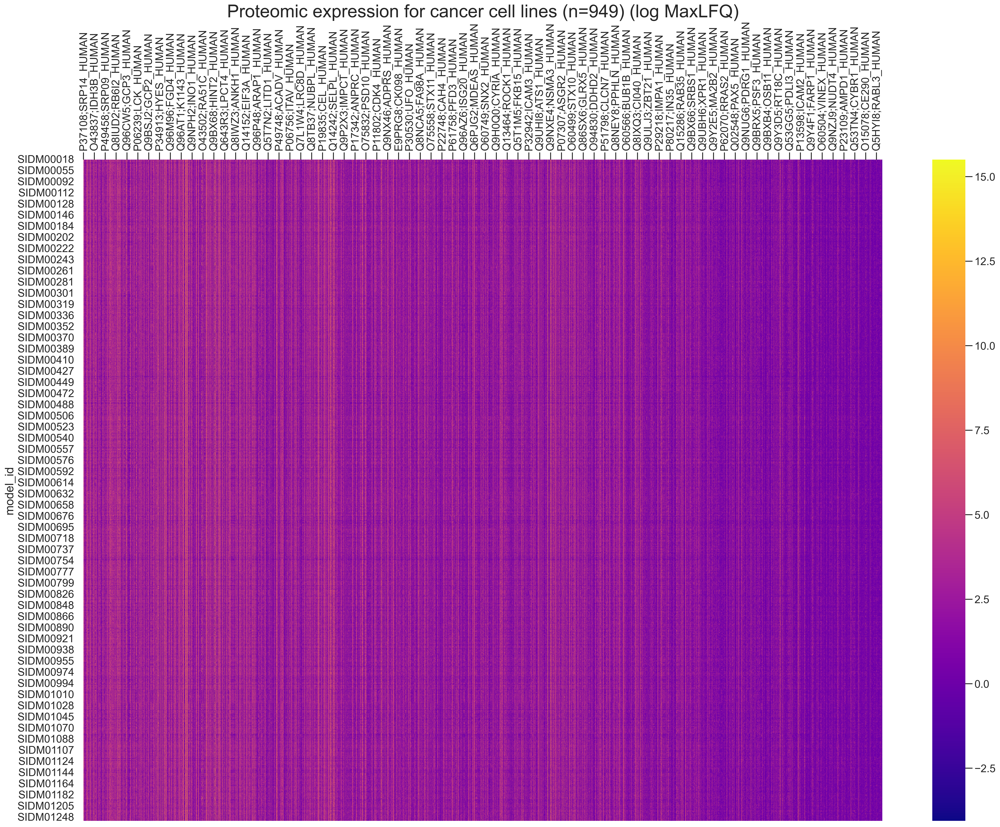

In [44]:
# visualise joined_sin_peptile_exclusion_matrix as a heatmap

import seaborn as sns
import matplotlib.pyplot as plt


fig, ax = plt.subplots(figsize=(30, 20))

sns.heatmap(joined_sin_peptile_exclusion_matrix, cmap='plasma')

# xlabel on top of heatmap
ax.xaxis.tick_top()

# rotate xtick labels
plt.xticks(rotation=90)

# set title 
plt.title('Proteomic expression for cancer cell lines (n=949) (log MaxLFQ)', fontsize=30)

plt.show()
# legend is labelled as 'proteomic expression (log MaxLFQ)'

In [46]:
# load in data

import pandas as pd
import pickle

# import GDSC2 drug response data using pickle

with open('data/drug-response/GDSC2/cache_gdsc2.pkl', 'rb') as f:
    gdsc2 = pickle.load(f)
    gdsc2_info = pickle.load(f)

# import CCLE gene expression data using pickle

with open('data/gene-expression/CCLE_Public_22Q2/ccle_expression.pkl', 'rb') as f:
    gene_entrez = pickle.load(f)
    ccle = pickle.load(f)

# import CCLE sample info data using pickle

with open('data/gene-expression/CCLE_Public_22Q2/ccle_sample_info.pkl', 'rb') as f:
    ccle_sample_info = pickle.load(f)


In [47]:
ccle.shape

(1406, 19222)

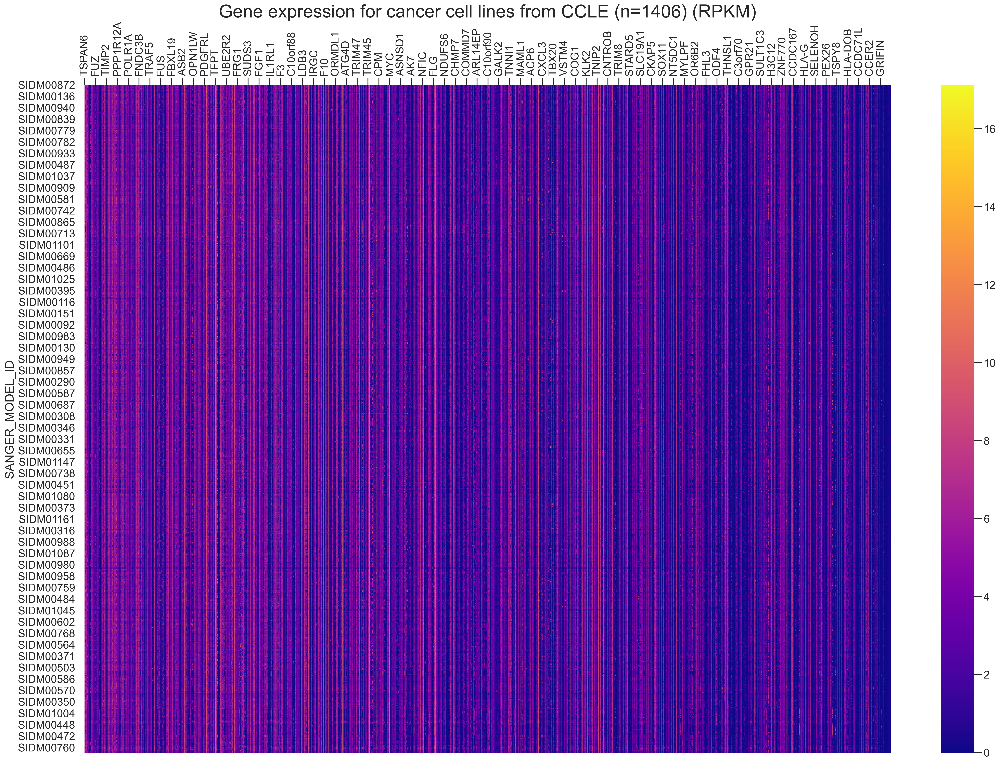

In [48]:
import DataFunctions as utils 

df = utils.create_joint_dataset_from_ccle_gdsc2('Palbociclib', gdsc2, ccle, ccle_sample_info)

feature_data, label_data = utils.create_feature_and_label(df)

# visualise ccle as a heatmap

fig, ax = plt.subplots(figsize=(30, 20))

sns.heatmap(feature_data, cmap='plasma')

# xlabel on top of heatmap
ax.xaxis.tick_top()

# rotate xtick labels
plt.xticks(rotation=90)

# set title
plt.title('Gene expression for cancer cell lines from CCLE (n=1406) (RPKM)', fontsize=30)

plt.show()

